In [121]:
%load_ext autoreload
%autoreload 2
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import WineDataSet
w = WineDataSet.WineDataSet()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [170]:
from matplotlib import rcParams

list(filter(lambda x: 'color' in x, list(rcParams.keys())))

['axes.edgecolor',
 'axes.facecolor',
 'axes.labelcolor',
 'axes.titlecolor',
 'boxplot.boxprops.color',
 'boxplot.capprops.color',
 'boxplot.flierprops.color',
 'boxplot.flierprops.markeredgecolor',
 'boxplot.flierprops.markerfacecolor',
 'boxplot.meanprops.color',
 'boxplot.meanprops.markeredgecolor',
 'boxplot.meanprops.markerfacecolor',
 'boxplot.medianprops.color',
 'boxplot.whiskerprops.color',
 'figure.edgecolor',
 'figure.facecolor',
 'grid.color',
 'hatch.color',
 'legend.edgecolor',
 'legend.facecolor',
 'legend.labelcolor',
 'lines.color',
 'lines.markeredgecolor',
 'lines.markerfacecolor',
 'patch.edgecolor',
 'patch.facecolor',
 'patch.force_edgecolor',
 'pcolor.shading',
 'pcolormesh.snap',
 'pdf.inheritcolor',
 'savefig.edgecolor',
 'savefig.facecolor',
 'scatter.edgecolors',
 'text.color',
 'xtick.color',
 'xtick.labelcolor',
 'ytick.color',
 'ytick.labelcolor']

hypothesies
   1 - fixed acidity

   2 - volatile acidity
          https://sinatech.info/en/acetic-volatile-acidity-in-wine-cider-vinegars-and-juices/
        acetic levels increase to a level where its characteristic odor begins to be perceived clearly (from 0.8 g / L) and modifies the aromatic characteristics (‘chopped’ flavor, ethyl acetate, acetoin)
        Acetic values above 1.2-1.5 g / L are no longer legal for wine

   3 - citric acid
        Citric acid is often added to wines to increase acidity, complement a specific flavor or prevent ferric hazes. It can be added to finished wines to increase acidity and give a “fresh” flavor. The disadvantage of adding citric acid is its microbial instability
        Within the EU citric acid can only be used for stabilisation purposes and final citric acid content should not exceed 1g/L.

   4 - residual sugar
        Wines can be organized by sweetness
       Dry                                                      0 – 4 g/L

Off Dry                                                5 – 11 g/L

Medium Sweet                                  12 – 35 g/L

Sweet                                                  Greater than 35 g/L

   5 - chlorides

   6 - free sulfur dioxide
   7 - total sulfur dioxide
   8 - density
    1 means that the wine is exactly like water

   9 - pH
       pH influences microbiological stability, affects the equilibrium of tartrate salts, determines the effectiveness of sulfur dioxide and enzyme additions, influences the solubility of proteins and effectiveness of bentonite and affects red wine colour and oxidative and browning reactions.

        The higher the pH, the less SO2 will be in the useful free form AND the less effective this free SO2 will be. herefore, all other things being equal, at a higher pH not only will more SO2 need to be added to achieve the desired level of free SO2, but the concentration of free SO2 required to have the desired antioxidant and antimicrobial properties will in itself also be greater. So if the vintage delivers higher than typical pH values, it’s important to think about adjusting SO2 levels during storage.

   10 - sulphates
        https://www.webmd.com/diet/what-to-know-sulfites-in-wine
        Sulfites – sometimes spelled “sulphites” – occur naturally in some foods and drinks. For centuries, people have used them as food preservatives. Today they are used to keep shrimp and lobster from turning dark, bleach some starches, and lessen bacterial growth in wine.

        In the United States, wines that contain 10 or more parts per million (ppm) of sulfites must state on the label that they contain sulfites. This rule applies to both imported and domestic wines.



   11 - alcohol

- There are wines with illegal so2 levels
- Presense of illegal so2 is correlated to wine quality
- Wines with >0.8g/L volatile acidity have different aromas, it correlates to quality
- There are illegal volatile acidity wine levels (>1.5g/L)
- Citric acid > 1g/L is illegal in EU, there are wines like that in the dataset
- Exciding citric acid levels correlate to quality
- There is a correlation between wine sweetness and quality
- Wines that are denser than water are more qualitative
- PH correlates to free so2 and quality
- There are wines with sulphates less than 10, which wouldn't need to be labeled in US

# legal limits in EU
https://en.wikipedia.org/wiki/European_Union_wine_regulations


https://eur-lex.europa.eu/legal-content/EN/TXT/PDF/?uri=CELEX:52021XC0202(02)&rid=5
total sulphur dioxide:
- for  <=5 g/l residual sugar - 200 mg/l
- for  >=5 g/l residual sugar - 250 mg/l

acidity
 - min total acidity 4/g per liter
 - max volatile acidity 16.7

alcohol
 - max 11.5%


Ads ideas:
- best wine for losing weight
- best wine for people with high stomach acidity
- don't drink water, drink wine! (it is a dense)

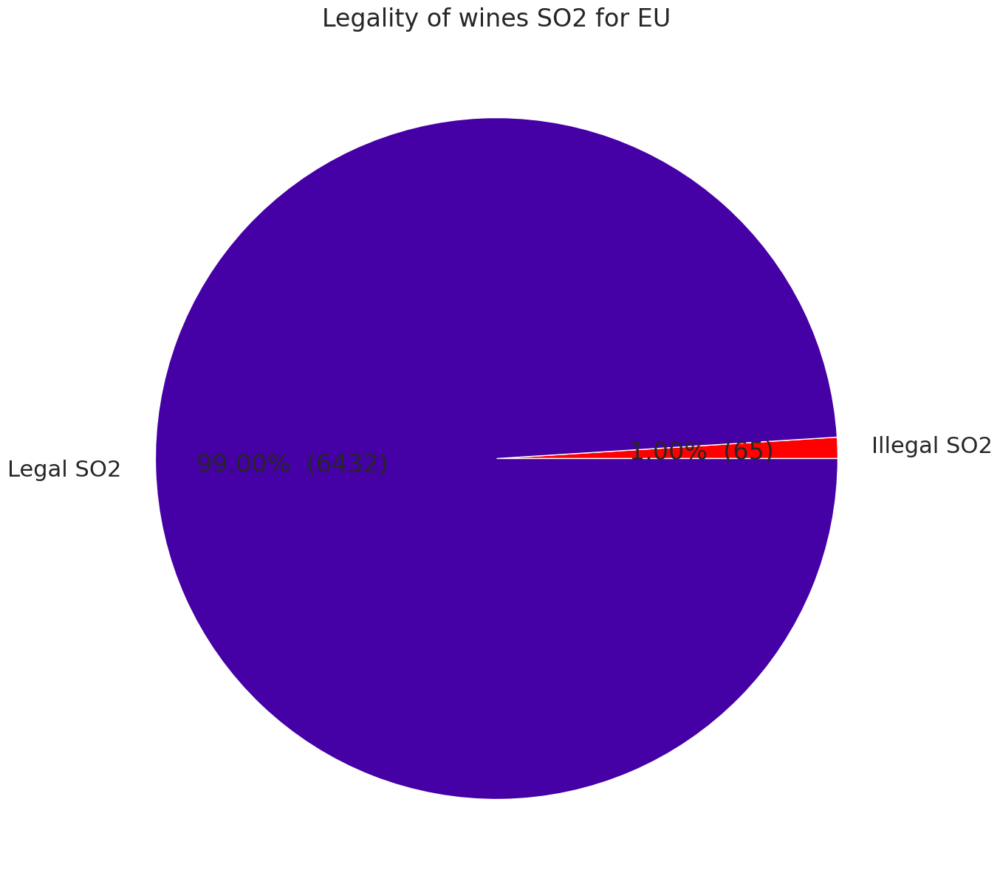

In [69]:
w.chart_illegal_so2('all')

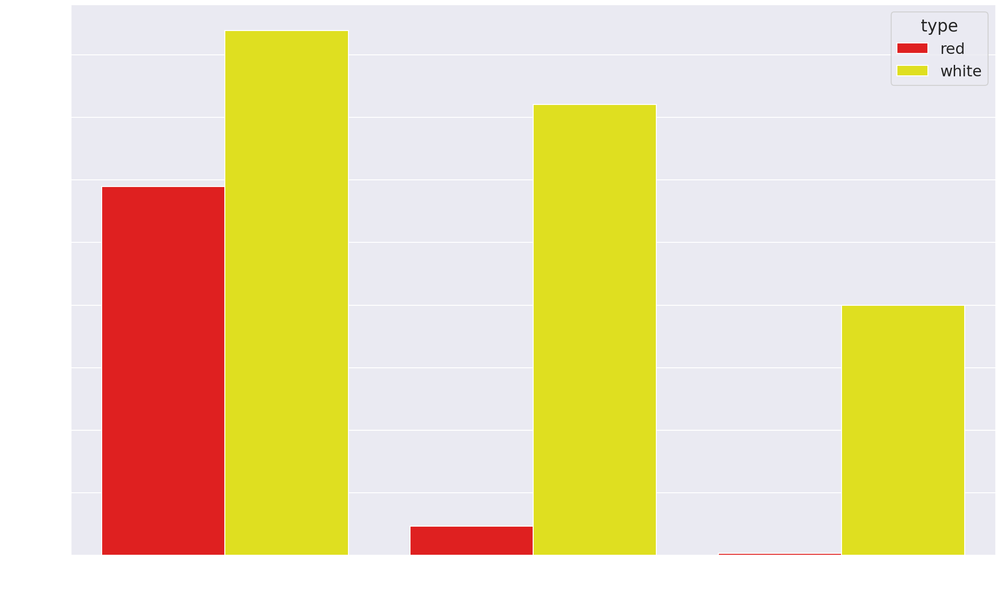

In [72]:
sns.set_context('talk', font_scale=1.4)
sns.set_palette('dark')
sns.countplot(x='sweetness', data=w.ds, hue='type', palette=[w.colors['red'], w.colors['white']])
plt.savefig('count_by_quality.png', transparent=True, facecolor='black')

In [3]:
display(w.ds.head())
#w.chart_illegal_so2('white')

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,...,quality,type,quality_label,sweetness,alcohol_label,cals from alcohol,cals from sugar,total calories,total acidity,above_so2_limit
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,...,5.0,red,low,dry,9,658.0,7.6,665.6,8.10,0.0
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,...,5.0,red,low,dry,9,686.0,10.4,696.4,8.68,0.0
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,...,5.0,red,low,dry,9,686.0,9.2,695.2,8.56,0.0
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,...,6.0,red,medium,dry,9,686.0,7.6,693.6,11.48,0.0
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,...,5.0,red,low,dry,9,658.0,7.6,665.6,8.10,0.0


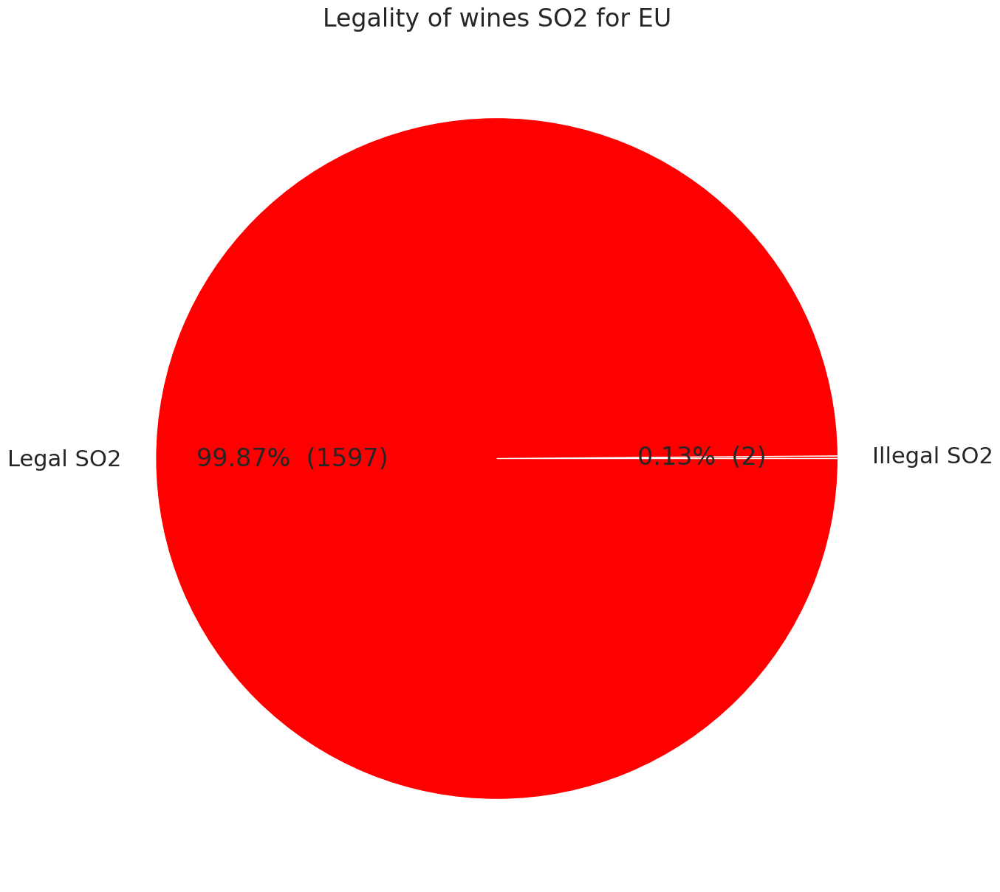

In [4]:
w.chart_illegal_so2('red')

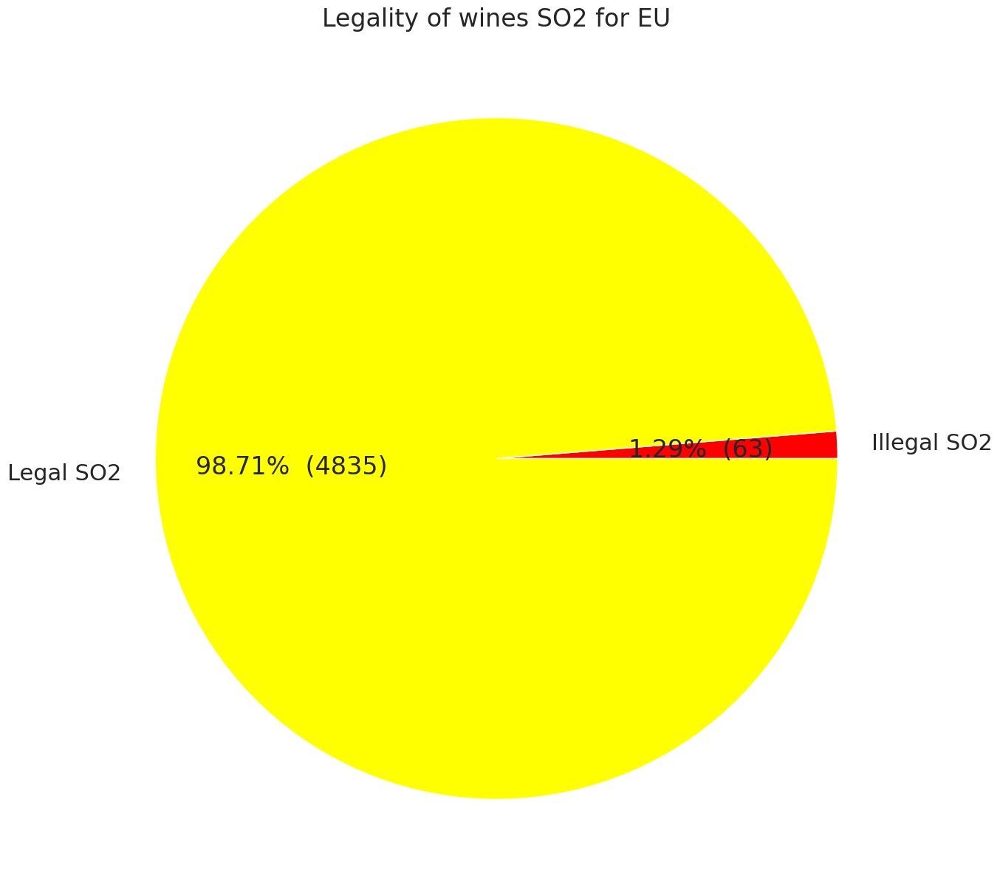

In [5]:
w.chart_illegal_so2('white')

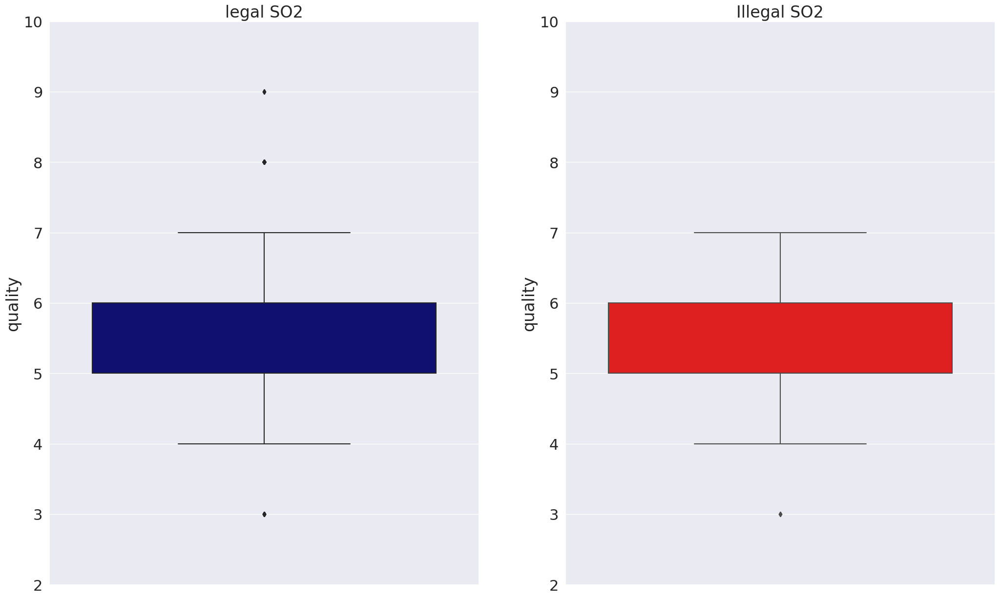

In [6]:
w.chart_illegal_so2_quality()

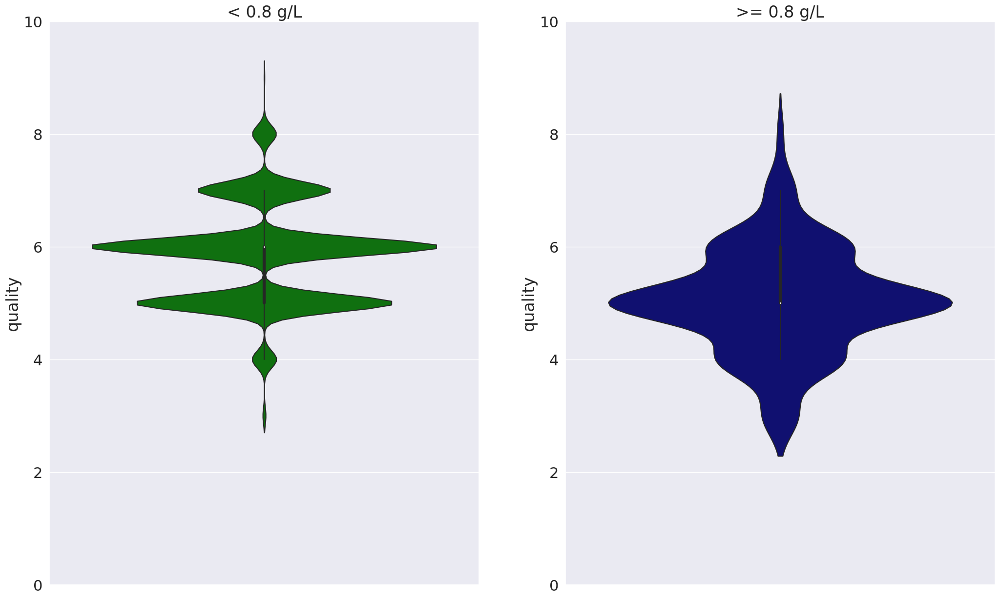

In [7]:
w.chart_volatile_acidity()

In [8]:
display(w.ds[w.ds['volatile acidity'] > 1.5])

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,...,quality,type,quality_label,sweetness,alcohol_label,cals from alcohol,cals from sugar,total calories,total acidity,above_so2_limit
1299,7.6,1.58,0.0,2.1,0.137,5.0,9.0,0.99476,3.5,0.4,...,3.0,red,low,dry,10,763.0,8.4,771.4,9.18,0.0


In [9]:
display(w.ds[w.ds['citric acid'] > 1])

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,...,quality,type,quality_label,sweetness,alcohol_label,cals from alcohol,cals from sugar,total calories,total acidity,above_so2_limit
2344,7.4,0.20,1.66,2.1,0.022,34.0,113.0,0.99165,3.26,0.55,...,6.0,white,medium,dry,12,854.0,8.4,862.4,7.60,0.0
4751,7.6,0.25,1.23,4.6,0.035,51.0,294.0,0.99018,3.03,0.43,...,6.0,white,medium,off-dry,13,917.0,18.4,935.4,7.85,94.0


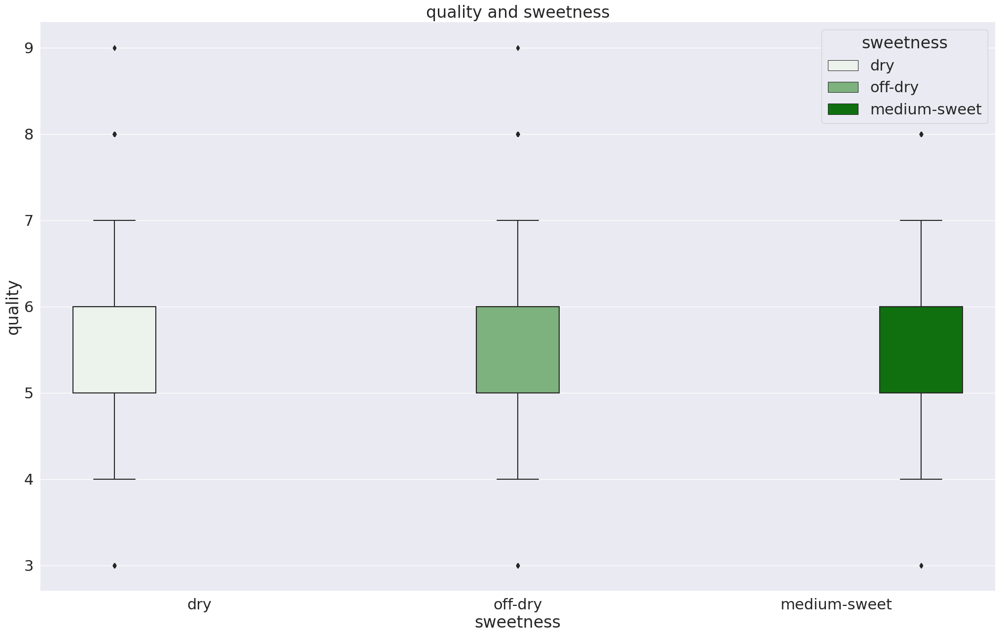

In [10]:
w.chart_sweetness_to_quality()

In [11]:
display(w.ds.loc[w.ds['sweetness'] == 'dry', 'density'].median())
display(w.ds.loc[w.ds['sweetness'] == 'off-dry', 'density'].median())
display(w.ds.loc[w.ds['sweetness'] == 'medium-sweet', 'density'].median())

0.9934

0.9948

0.99807

In [12]:
w.ds[['sweetness', 'residual sugar']]

,sweetness,residual sugar
0,dry,1.9
1,dry,2.6
2,dry,2.3
3,dry,1.9
4,dry,1.9
...,...,...
6492,dry,1.6
6493,off-dry,8.0
6494,dry,1.2
6495,dry,1.1


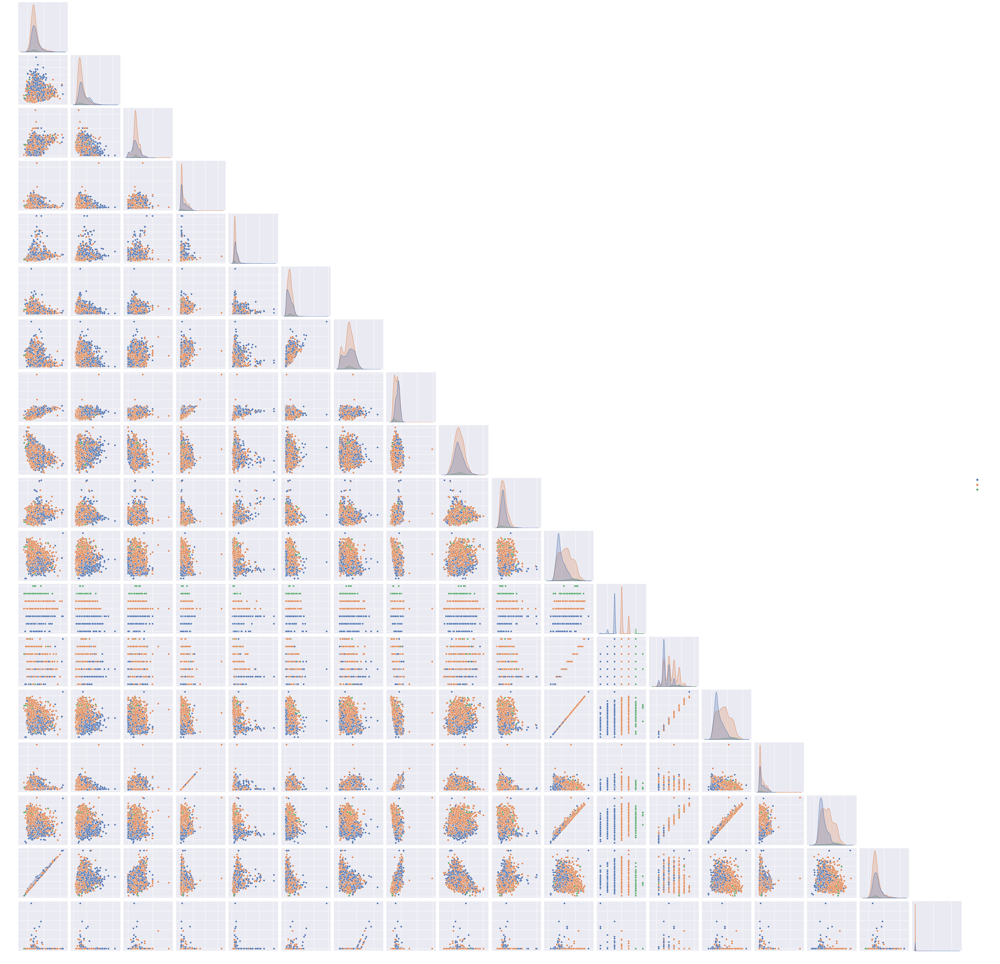

In [175]:
# pair_ds = w.ds[['total acidity', 'alcohol', 'residual sugar', 'density', 'pH', 'quality_label']]
pair_ds = w.ds
sns.pairplot(pair_ds, hue='quality_label', corner=True)

w.sv()

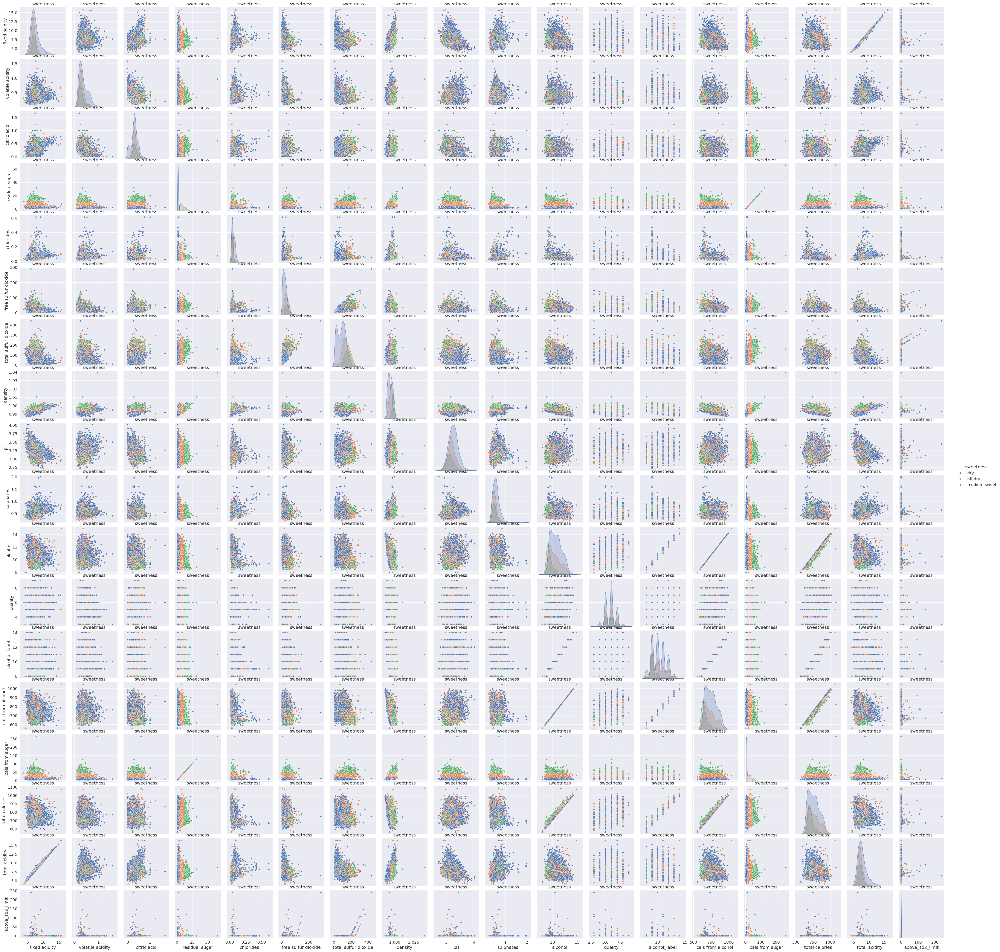

In [14]:
w.chart_pair('sweetness')

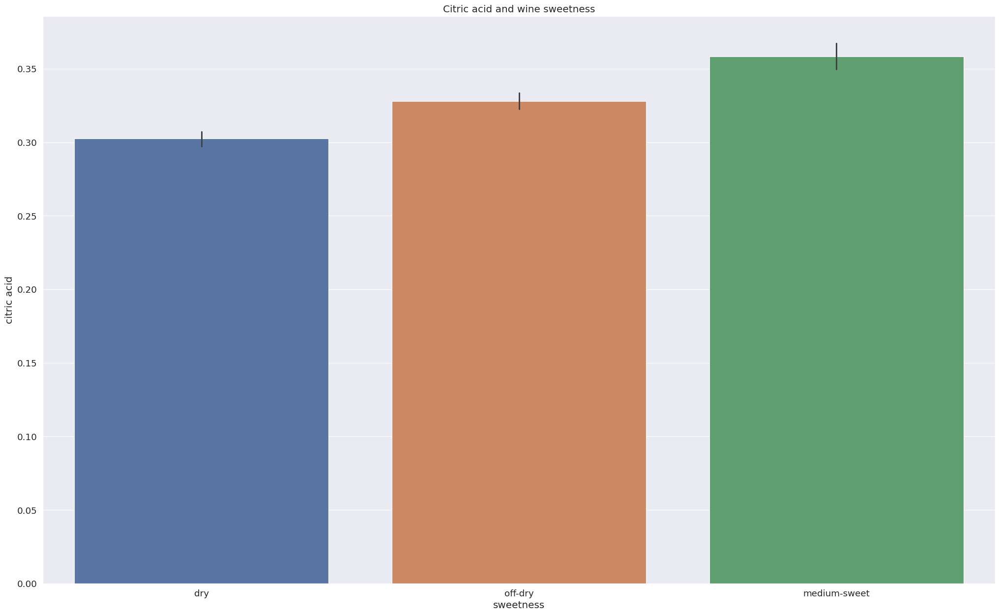

In [15]:
w.chart_sweetness_citric_acid()

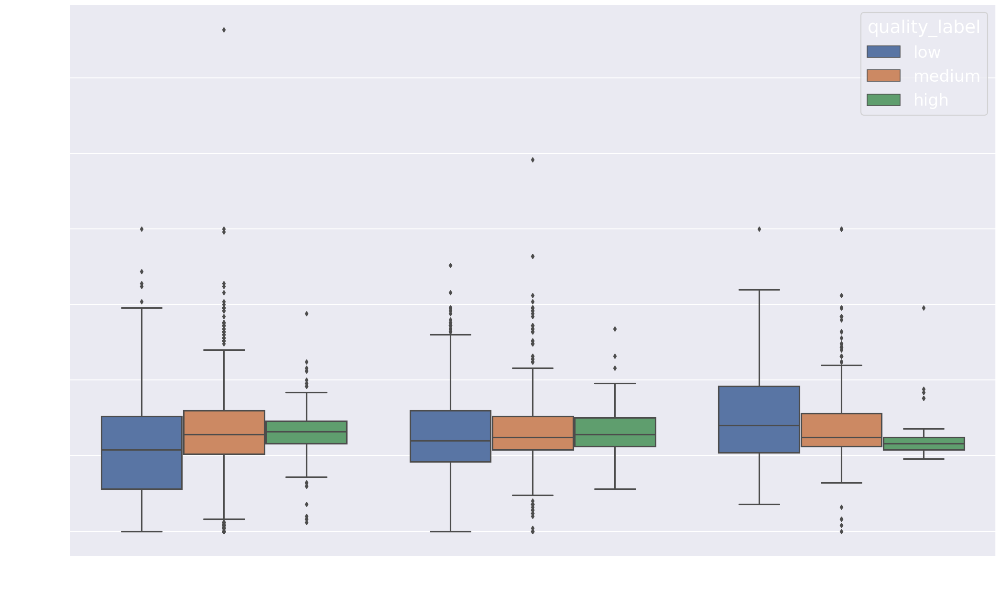

In [124]:
sns.set_context('talk', font_scale=1.5)
sns.boxplot(x='sweetness', y='citric acid', data=w.ds, hue='quality_label')
w.sv()

/tmp/ipykernel_6315/1105381718.py:2: UserWarning: 
The palette list has fewer values (1) than needed (2) and will cycle, which may produce an uninterpretable plot.
  sns.stripplot(


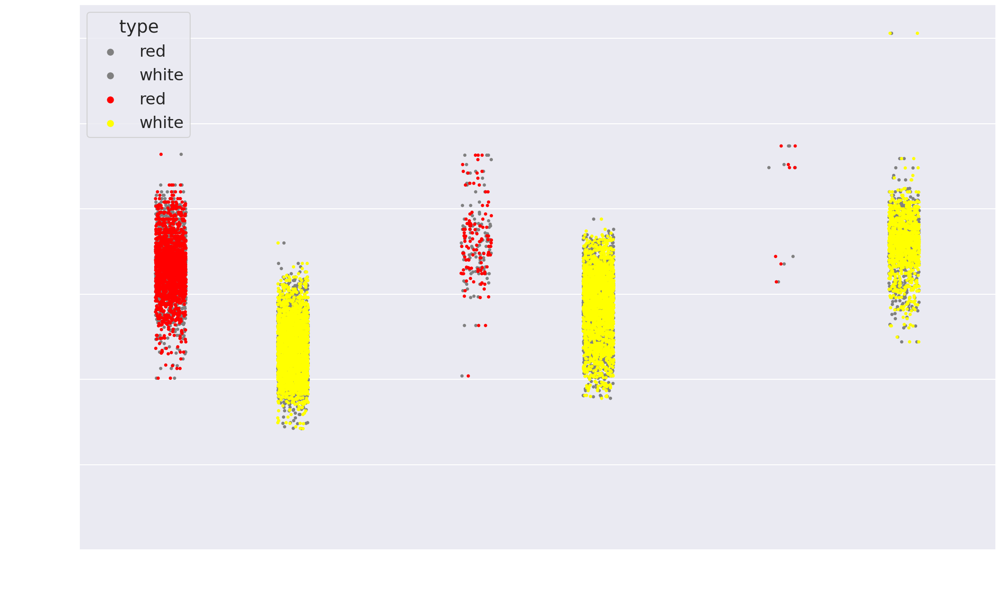

In [119]:
sns.set_context('talk', font_scale=1.5)
sns.stripplot(
    x='sweetness', y='density', data=w.ds,
    hue='type',
    jitter=True,
    dodge=True,
    palette=['gray']
).set(ylim=(0.98, 1.012))

sns.stripplot(
    x='sweetness', y='density',
    data=w.ds.loc[(w.ds['density'] >= 0.998) & (w.ds['density'] <= 1.002)],
    hue='type',
    jitter=True,
    dodge=True,
    palette=[w.colors['red'], w.colors['white']]
).set(ylim=(0.98, 1.012))
w.sv()

In [86]:
len(w.ds.loc[(w.ds['density'] >= 0.998) & (w.ds['density'] <= 1.002)])

919

[Text(0.5, 1.0, 'Volatile acidity and wine quality')]

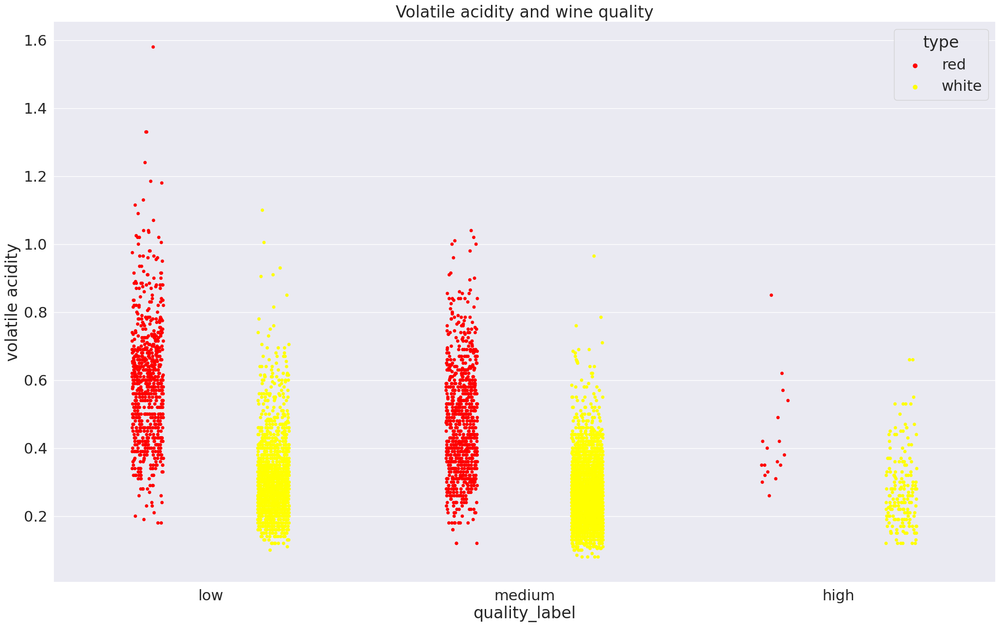

In [23]:
sns.stripplot(
    x='quality_label', y='volatile acidity', data=w.ds,
    hue='type',
    jitter=True,
    dodge=True,
    palette=[w.colors['red'], w.colors['white']]
).set(title='Volatile acidity and wine quality')

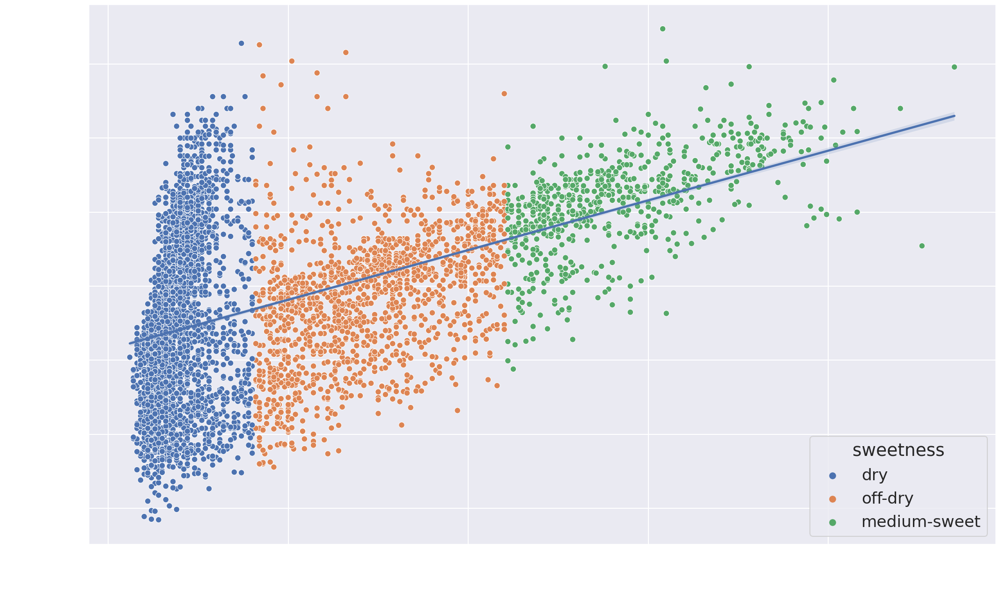

In [100]:
sns.set_context('talk', font_scale=1.5)
sns.scatterplot(x='residual sugar', y='density', hue='sweetness',  data=w.ds[w.ds['residual sugar'] < 25],
                color=w.sw_col_arr)
sns.regplot(x='residual sugar', y='density',  scatter=False,
            data=w.ds[w.ds['residual sugar'] < 25]
)
w.sv()

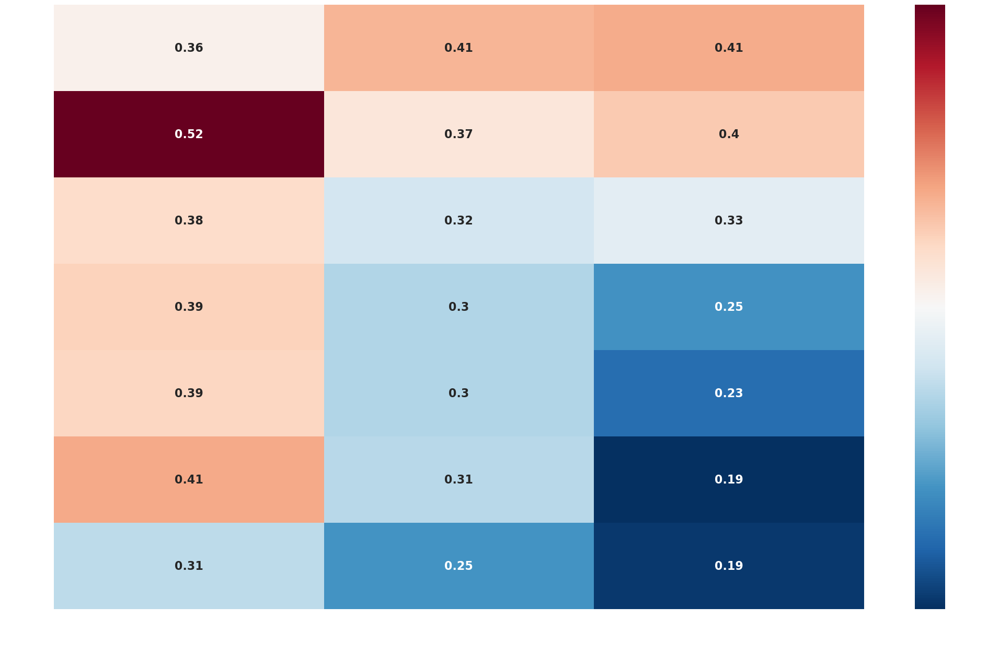

In [109]:
sns.set_context('talk', font_scale=1.5)
pv = w.ds.pivot_table(index='alcohol_label', columns='quality_label', values='volatile acidity')
pv = pv.sort_values(by=['alcohol_label'], ascending=False)
sns.heatmap(
    pv,
    cmap='RdBu_r',
    annot=True,
    annot_kws={'fontsize':16, 'fontweight':'bold'}
)
w.sv()

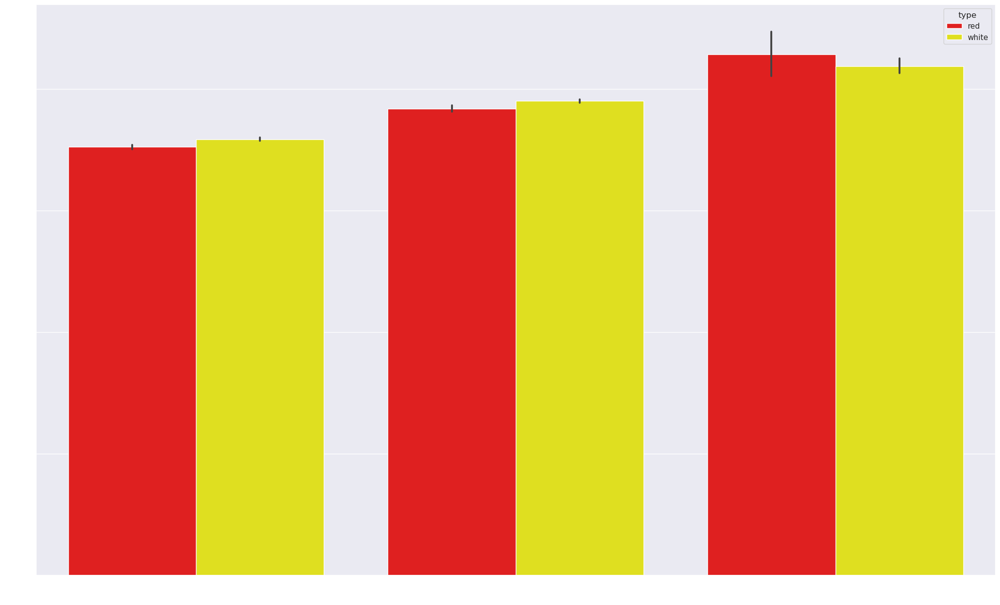

In [81]:
sns.barplot(
    x='quality_label', y='total calories',
    data=w.ds, hue='type',
    palette=[w.colors['red'], w.colors['white']]
)
w.sv()

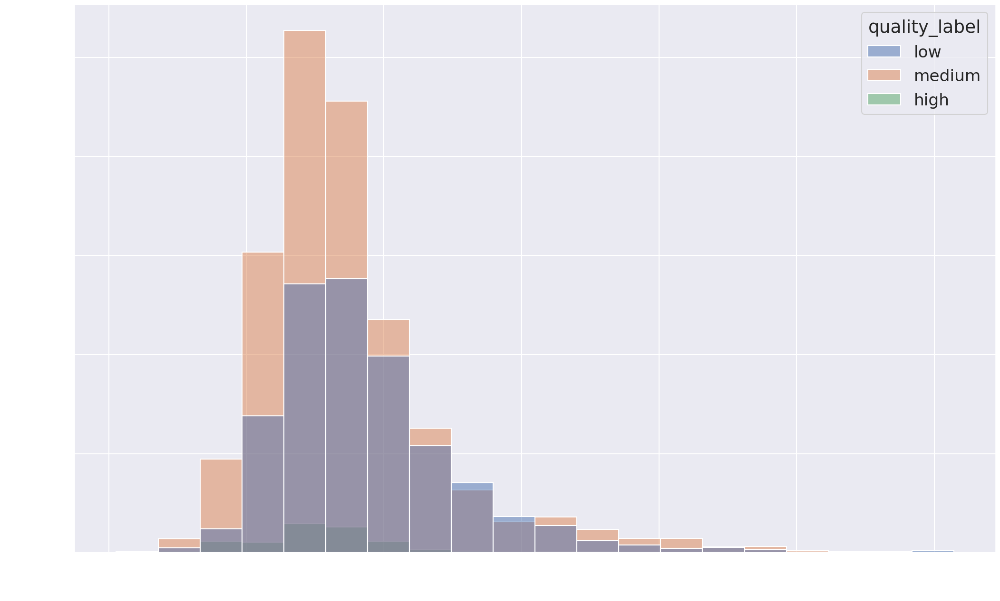

In [117]:
sns.set_context('talk', font_scale=1.5)
sns.histplot(x='total acidity', data=w.ds, bins=20, hue="quality_label")
w.sv()

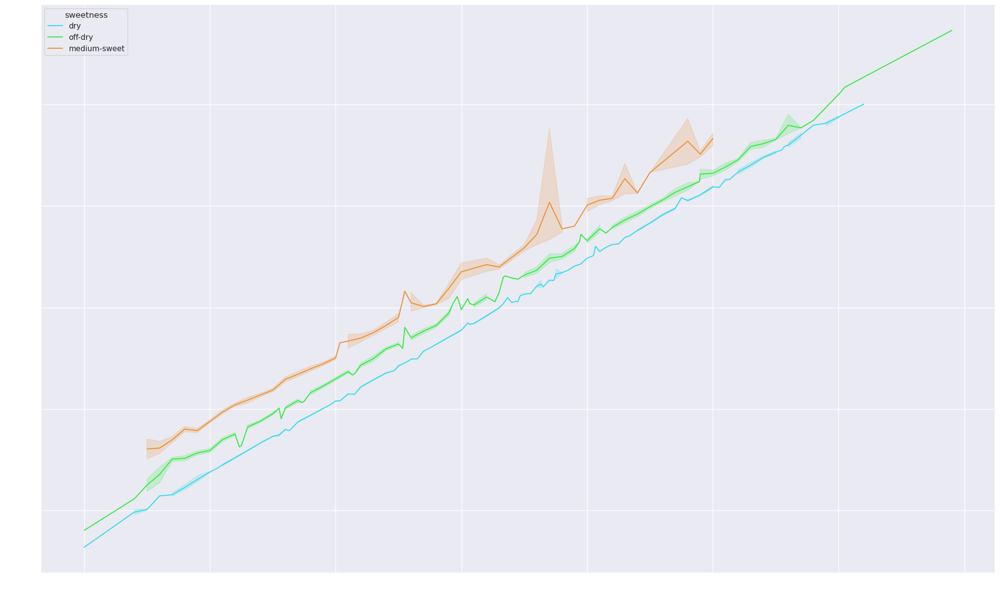

In [79]:

sns.lineplot(
x = 'alcohol', y = 'total calories',
data = w.ds, hue = 'sweetness',
palette = [w.sw_colors['dry'], w.sw_colors['off-dry'], w.sw_colors['medium-sweet']]
)
w.sv()

[Text(0.5, 1.0, 'Calories/L and wine quality')]

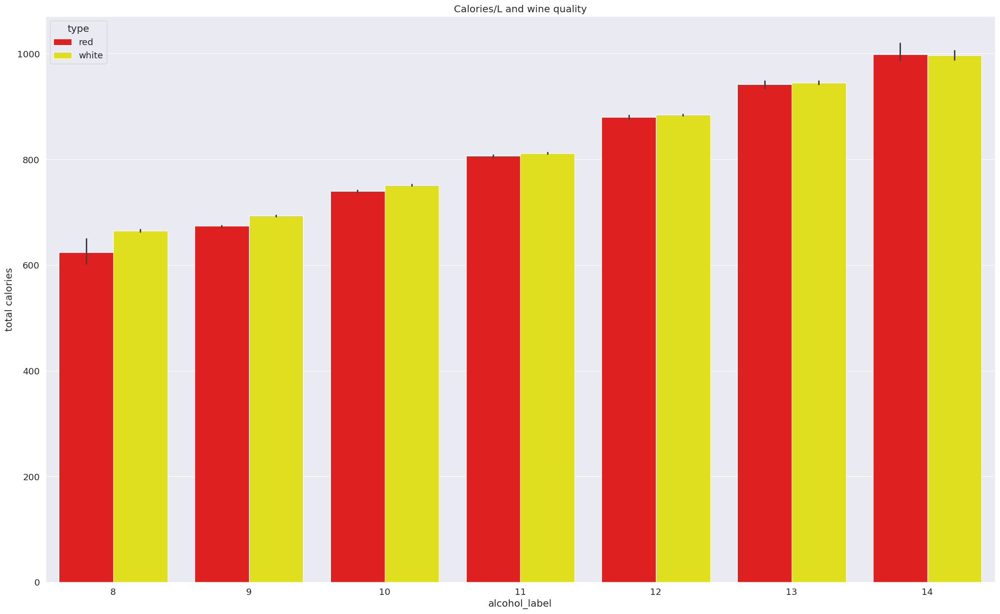

In [32]:
sns.barplot(
    x='alcohol_label', y='total calories',
    data=w.ds, hue='type',
    palette=[w.colors['red'], w.colors['white']]
).set(title='Calories/L and alcohol amount')

In [34]:
display(w.ds[['alcohol', 'pH']])

,alcohol,pH
0,9.4,3.51
1,9.8,3.20
2,9.8,3.26
3,9.8,3.16
4,9.4,3.51
...,...,...
6492,11.2,3.27
6493,9.6,3.15
6494,9.4,2.99
6495,12.8,3.34


[Text(0.5, 1.0, 'Sweetness and density of red and white wines')]

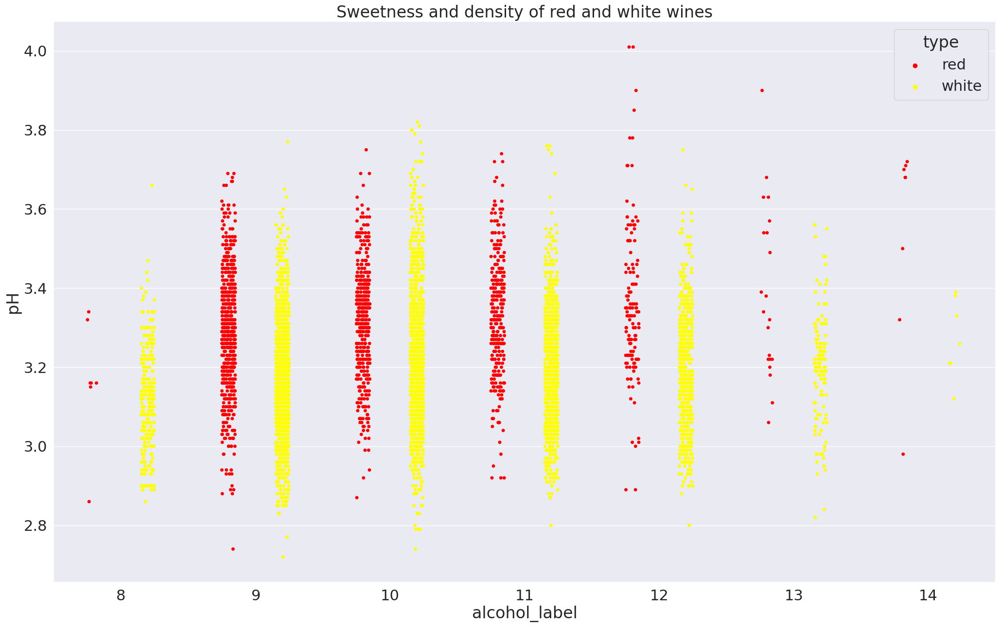

In [30]:
sns.stripplot(
    x='alcohol_label', y='pH', data=w.ds,
    hue='type',
    jitter=True,
    dodge=True,
    palette=[w.colors['red'], w.colors['white']]
).set(title='Sweetness and density of red and white wines')


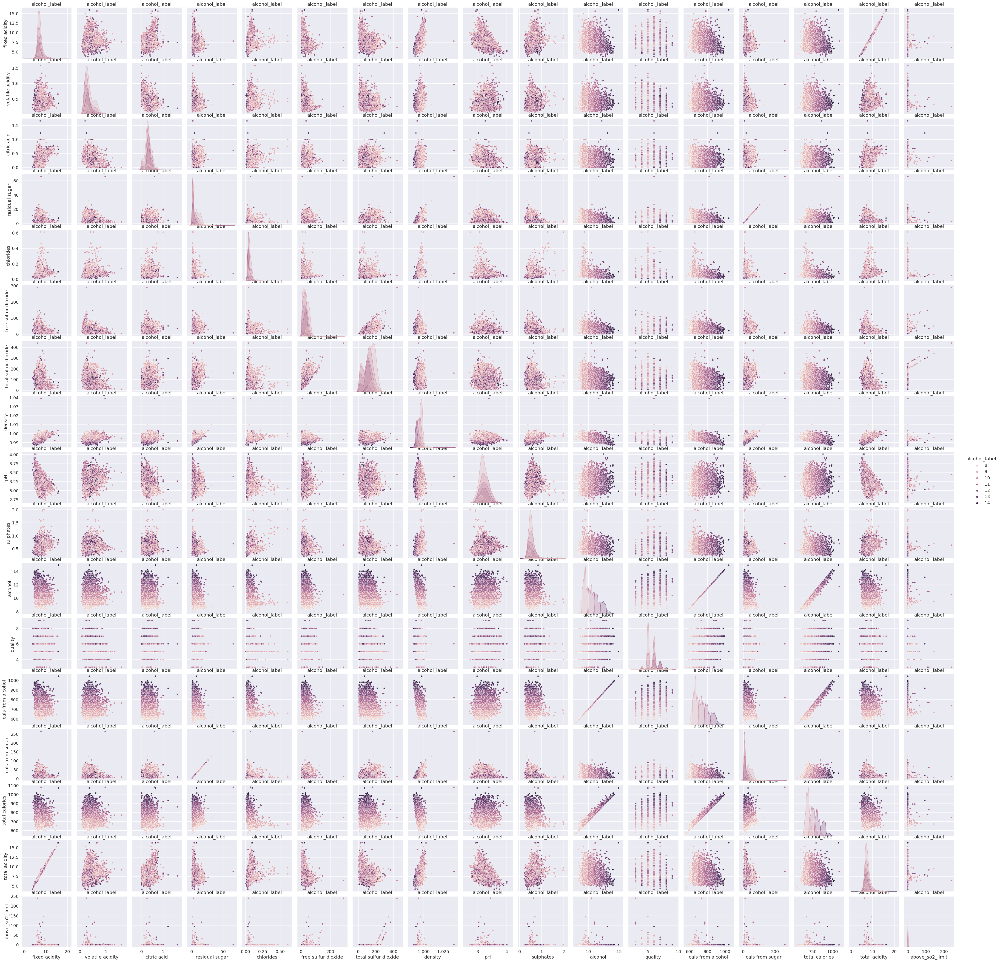

In [31]:
w.chart_pair('alcohol_label')

[Text(0.5, 1.0, 'Sweetness and density of red and white wines')]

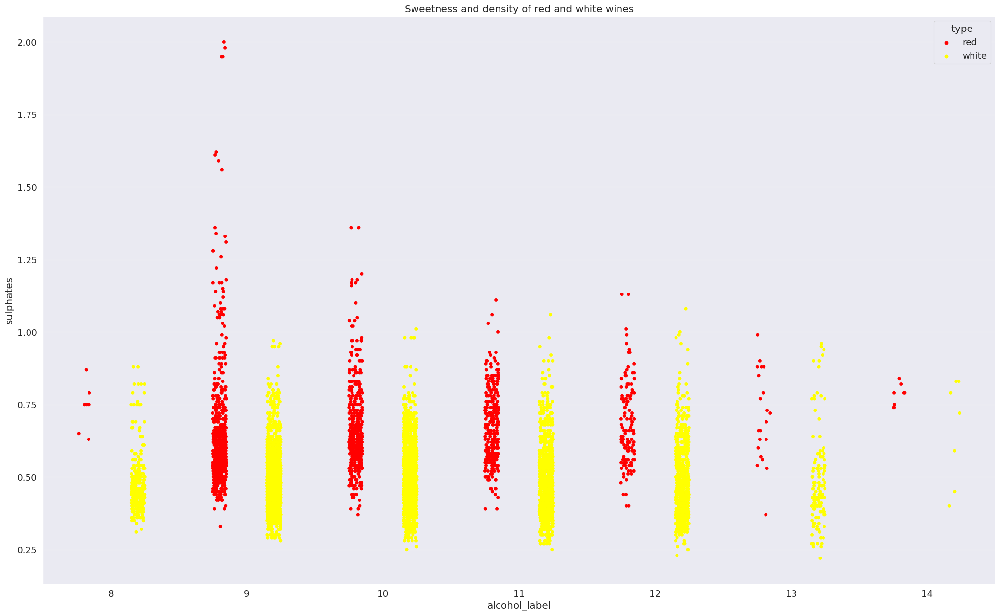

In [33]:
sns.set_context('talk', font_scale=1.5)
sns.stripplot(
    x='alcohol_label', y='sulphates', data=w.ds,
    hue='type',
    jitter=True,
    dodge=True,
    palette=[w.colors['red'], w.colors['white']]
)

In [37]:
len(w.ds[w.ds['type'] == 'white'])

4898

/home/user/anaconda3/envs/env310/lib/python3.10/site-packages/seaborn/axisgrid.py:712: UserWarning: Using the stripplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


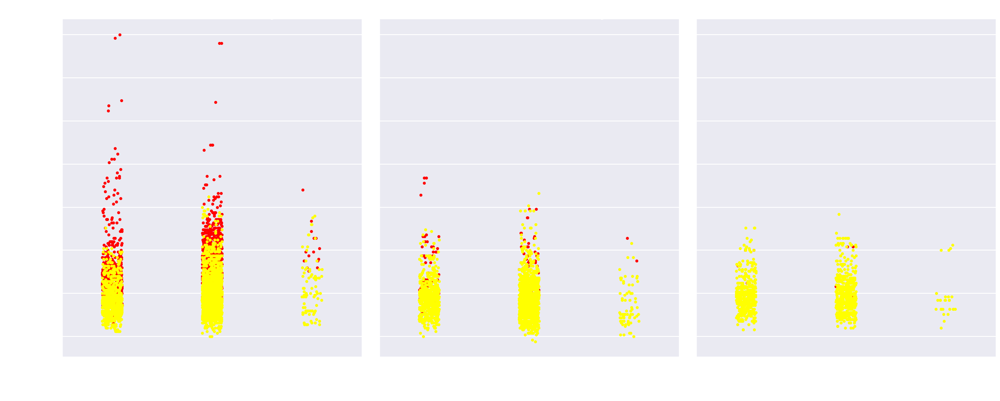

In [151]:
sns.set_context('talk', font_scale=1.5)
kws = {'jitter':True, 'dodge':True}
fg = sns.FacetGrid(
    w.ds,
    col='sweetness',
    hue='type',
    palette=w.col_arr,
    height=10, aspect=0.8,
)
fg.map(sns.stripplot, 'quality_label', 'sulphates')

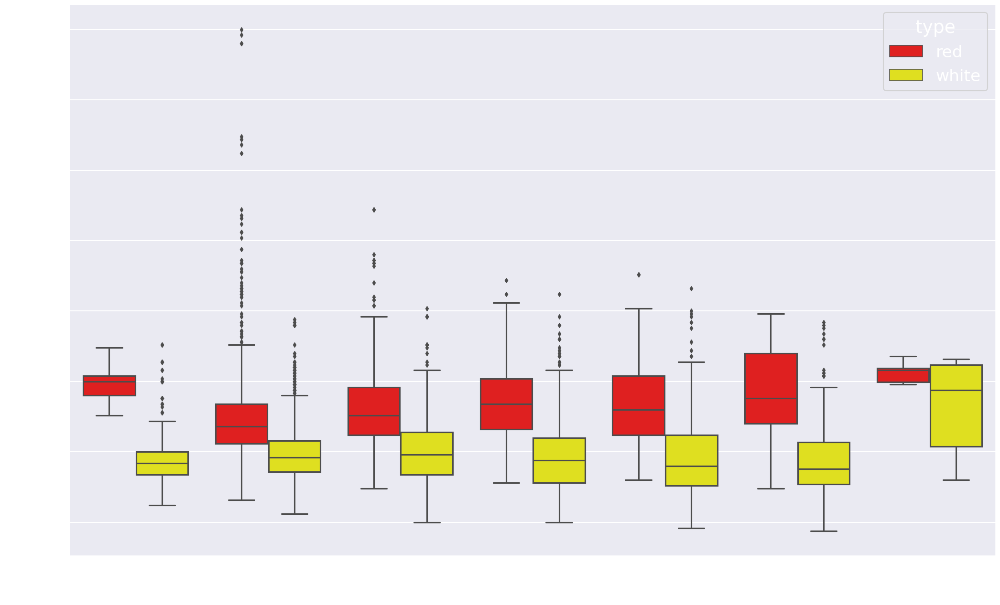

In [155]:
sns.set_context('talk', font_scale=1.5)
sns.boxplot(
    x='alcohol_label', y='sulphates', data=w.ds,
    hue='type',
    palette=[w.colors['red'], w.colors['white']]
)
w.sv()

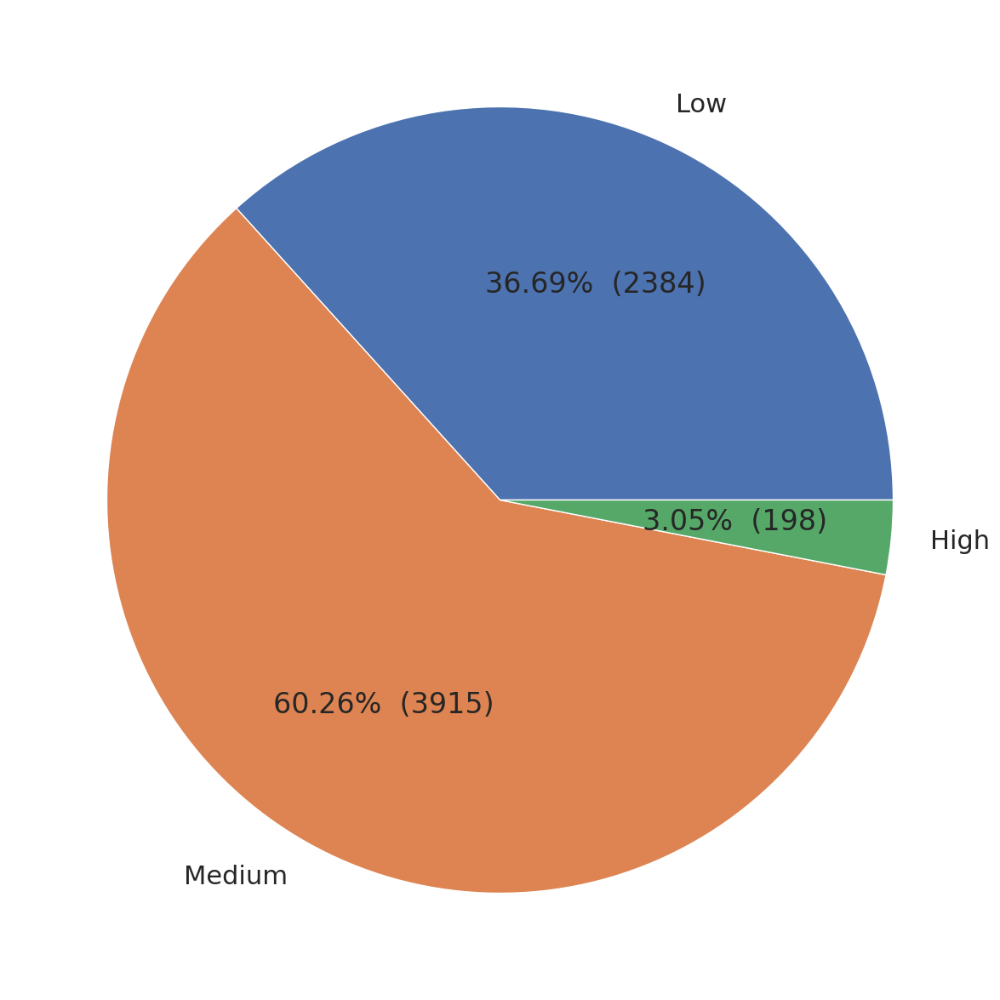

In [165]:
 # are we looking at specific wine type?

l = len(w.ds[w.ds['quality_label'] == 'low'])
m = len(w.ds[w.ds['quality_label'] == 'medium'])
h = len(w.ds[w.ds['quality_label'] == 'high'])
dt = [l, m, h]
labels = ['Low', 'Medium', 'High']
#colors = ['red', self.colors[wine_type]]

sns.set(rc={'figure.figsize': (25, 15)})
sns.set(font_scale=2)
#plt.title('Legality of wines SO2 for EU')
plt.pie(dt, labels=labels, autopct=w.make_autopct(dt))
w.sv()

In [ ]:
Sommelier Level 	Average Salary Range
Level 1: Introductory Sommelier 	$40–50k
Level 2: Certified Sommelier 	$60–70k
Level 3: Advanced Sommelier 	$70–80k
Level 4: Master Sommelier 	$150k